In [56]:
import pandas as pd
import numpy as np
import scipy.optimize as opt
import matplotlib.pyplot as plt
from tqdm import tqdm
import warnings
warnings.filterwarnings('ignore')
import multiprocessing
from pathlib import Path
import pathlib
from tqdm.notebook import tqdm
import pyproj
from pyproj import Proj, transform
import pickle
INPUT = '../../input/google-smartphone-decimeter-challenge/'
root = Path(INPUT)

In [51]:
EXP_NAME = str(Path().resolve()).split('/')[-1]

In [2]:
def ecef2lla(x, y, z):
    # x, y and z are scalars or vectors in meters
    x = np.array([x]).reshape(np.array([x]).shape[-1], 1)
    y = np.array([y]).reshape(np.array([y]).shape[-1], 1)
    z = np.array([z]).reshape(np.array([z]).shape[-1], 1)

    a=6378137
    a_sq=a**2
    e = 8.181919084261345e-2
    e_sq = 6.69437999014e-3

    f = 1/298.257223563
    b = a*(1-f)

    # calculations:
    r = np.sqrt(x**2 + y**2)
    ep_sq  = (a**2-b**2)/b**2
    ee = (a**2-b**2)
    f = (54*b**2)*(z**2)
    g = r**2 + (1 - e_sq)*(z**2) - e_sq*ee*2
    c = (e_sq**2)*f*r**2/(g**3)
    s = (1 + c + np.sqrt(c**2 + 2*c))**(1/3.)
    p = f/(3.*(g**2)*(s + (1./s) + 1)**2)
    q = np.sqrt(1 + 2*p*e_sq**2)
    r_0 = -(p*e_sq*r)/(1+q) + np.sqrt(0.5*(a**2)*(1+(1./q)) - p*(z**2)*(1-e_sq)/(q*(1+q)) - 0.5*p*(r**2))
    u = np.sqrt((r - e_sq*r_0)**2 + z**2)
    v = np.sqrt((r - e_sq*r_0)**2 + (1 - e_sq)*z**2)
    z_0 = (b**2)*z/(a*v)
    h = u*(1 - b**2/(a*v))
    phi = np.arctan((z + ep_sq*z_0)/r)
    lambd = np.arctan2(y, x)

    return phi*180/np.pi, lambd*180/np.pi, h

def calc_haversine(lat1, lon1, lat2, lon2):
    """Calculates the great circle distance between two points
    on the earth. Inputs are array-like and specified in decimal degrees.
    """
    RADIUS = 6_367_000
    lat1, lon1, lat2, lon2 = map(np.radians, [lat1, lon1, lat2, lon2])
    dlat = lat2 - lat1
    dlon = lon2 - lon1
    a = np.sin(dlat/2)**2 + \
      np.cos(lat1) * np.cos(lat2) * np.sin(dlon/2)**2
    dist = 2 * RADIUS * np.arcsin(a**0.5)
    return dist

In [3]:
def WGS84_to_ECEF(lat, lon, alt):
    # convert to radians
    rad_lat = lat * (np.pi / 180.0)
    rad_lon = lon * (np.pi / 180.0)
    a    = 6378137.0
    # f is the flattening factor
    finv = 298.257223563
    f = 1 / finv   
    # e is the eccentricity
    e2 = 1 - (1 - f) * (1 - f)    
    # N is the radius of curvature in the prime vertical
    N = a / np.sqrt(1 - e2 * np.sin(rad_lat) * np.sin(rad_lat))
    x = (N + alt) * np.cos(rad_lat) * np.cos(rad_lon)
    y = (N + alt) * np.cos(rad_lat) * np.sin(rad_lon)
    z = (N * (1 - e2) + alt)        * np.sin(rad_lat)
    return x, y, z

transformer = pyproj.Transformer.from_crs(
    {"proj":'geocent', "ellps":'WGS84', "datum":'WGS84'},
    {"proj":'latlong', "ellps":'WGS84', "datum":'WGS84'},)
    
def ECEF_to_WGS84(x,y,z):
    lon, lat, alt = transformer.transform(x,y,z,radians=False)
    return lon, lat, alt

In [4]:
def gnss_log_to_dataframes(path):
    '''Load GNSS Log'''
    print('Loading ' + path, flush = True)
    gnss_section_names = {'Raw', 'UncalAccel', 'UncalGyro', 'UncalMag', 'Fix', 'Status', 'OrientationDeg'}
    with open(path) as f_open:
        datalines = f_open.readlines()

    datas = {k: [] for k in gnss_section_names}
    gnss_map = {k: [] for k in gnss_section_names}
    for dataline in datalines:
        is_header = dataline.startswith('#')
        dataline = dataline.strip('#').strip().split(',')
        # skip over notes, version numbers, etc
        if is_header and dataline[0] in gnss_section_names:
            gnss_map[dataline[0]] = dataline[1:]
        elif not is_header:
            datas[dataline[0]].append(dataline[1:])

    results = dict()
    for k, v in datas.items():
        results[k] = pd.DataFrame(v, columns=gnss_map[k])
    # pandas doesn't properly infer types from these lists by default
    for k, df in results.items():
        for col in df.columns:
            if col == 'CodeType':
                continue
            results[k][col] = pd.to_numeric(results[k][col])

    return results

In [5]:
# apply tips1
# _derivedのmillisSinceGpsEpochが次のepoch(rawの)を示しているので元に戻す
def apply_tips1(raw_df, derived_df):
    # Create a new column in df_raw that corresponds to derivedの['millisSinceGpsEpoch']
    raw_df['millisSinceGpsEpoch'] = np.floor((raw_df['TimeNanos'] - raw_df['FullBiasNanos']) / 1000000.0).astype(int)
        
    # Change each value in df_derived['MillisSinceGpsEpoch'] to be the prior epoch.
    raw_timestamps = raw_df['millisSinceGpsEpoch'].unique()
    derived_timestamps = derived_df['millisSinceGpsEpoch'].unique()

    # The timestamps in derived are one epoch ahead. We need to map each epoch
    # in derived to the prior one (in Raw).
    indexes = np.searchsorted(raw_timestamps, derived_timestamps)
    from_t_to_fix_derived = dict(zip(derived_timestamps, raw_timestamps[indexes-1]))
    derived_df['millisSinceGpsEpoch'] = np.array(list(map(lambda v: from_t_to_fix_derived[v], derived_df['millisSinceGpsEpoch'])))
    return derived_df

# apply tips5
# derivedの重複している行を削除
def apply_tips5(derived_df):
    delta_millis = derived_df['millisSinceGpsEpoch'] - derived_df['receivedSvTimeInGpsNanos'] / 1e6
    where_good_signals = (delta_millis > 0) & (delta_millis < 300)
    return derived_df[where_good_signals]

def apply_tips4(derived_df):
    derived_df['heightAboveWgs84EllipsoidM'] = derived_df['heightAboveWgs84EllipsoidM'].values - 61
    return derived_df

## datasetの作成

In [6]:
base_train = pd.read_csv(root/'baseline_locations_train.csv')
base_test = pd.read_csv(root/'baseline_locations_test.csv')

In [7]:
def create_dataset(input_df, phase='train', show=False):
    output_df = pd.DataFrame()
    for (cname,pname), df in tqdm(input_df.groupby(['collectionName', 'phoneName'])):
        derived_df = pd.read_csv(root/f'{phase}/{cname}/{pname}/{pname}_derived.csv')
        derived_df = derived_df.sort_values('millisSinceGpsEpoch')
        # tipsを適用
        gnss_df = gnss_log_to_dataframes(str(root / f"{phase}/{cname}/{pname}/{pname}_GnssLog.txt"))
        raw_df = gnss_df['Raw']
        derived_df = apply_tips1(raw_df, derived_df)
        derived_df = apply_tips5(derived_df)

        # 補正したpseudo range
        derived_df['correctedPrM'] = derived_df.apply(lambda r: r.rawPrM + r.satClkBiasM - r.isrbM - r.ionoDelayM - r.tropoDelayM,axis=1)
        
        # targetラベル作成
        if phase == 'train':
            gt = pd.read_csv(root/f'{phase}/{cname}/{pname}/ground_truth.csv')
            gt = gt[['millisSinceGpsEpoch','latDeg', 'lngDeg','heightAboveWgs84EllipsoidM']].sort_values('millisSinceGpsEpoch')
            derived_df = pd.merge_asof(derived_df, gt, on=['millisSinceGpsEpoch'], tolerance=10, direction='nearest')
            # derived_df = derived_df.merge(gt, on=['collectionName','phoneName', 'millisSinceGpsEpoch'])
            derived_df = apply_tips4(derived_df)

            # 緯度経度をECEF座標に変換
            x, y, z = WGS84_to_ECEF(derived_df['latDeg'], derived_df['lngDeg'], derived_df['heightAboveWgs84EllipsoidM'])
            derived_df['x'] = x
            derived_df['y'] = y
            derived_df['z'] = z

            # 真のrangeを算出
            derived_df['rM_gt'] = derived_df.apply(lambda r: ((r.xSatPosM - r.x)**2 + (r.ySatPosM - r.y)**2 + (r.zSatPosM - r.z)**2)**0.5, axis=1)

        output_df = pd.concat([output_df, derived_df])

        # 可視化
        if (show == True)*(phase=='train'):
            plt.figure(figsize=(10,3))
            plt.title(f'{cname} / {pname}')
            (derived_df['rM_gt'] - derived_df['correctedPrM']).plot()
            plt.ylabel('error')
            plt.show()
        
    return output_df.reset_index(drop=True)

  0%|          | 0/73 [00:00<?, ?it/s]

Loading ../../input/google-smartphone-decimeter-challenge/train/2020-05-14-US-MTV-1/Pixel4/Pixel4_GnssLog.txt


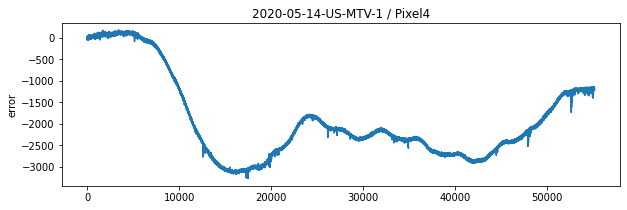

Loading ../../input/google-smartphone-decimeter-challenge/train/2020-05-14-US-MTV-1/Pixel4XLModded/Pixel4XLModded_GnssLog.txt


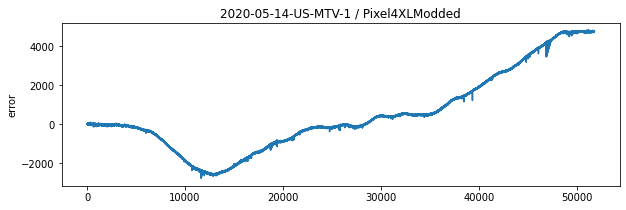

Loading ../../input/google-smartphone-decimeter-challenge/train/2020-05-14-US-MTV-2/Pixel4/Pixel4_GnssLog.txt


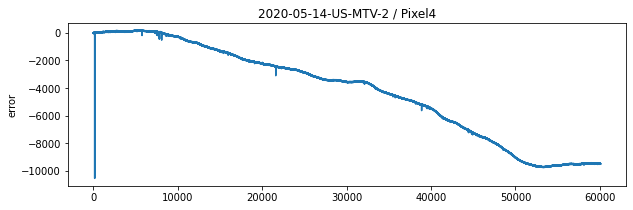

Loading ../../input/google-smartphone-decimeter-challenge/train/2020-05-14-US-MTV-2/Pixel4XLModded/Pixel4XLModded_GnssLog.txt


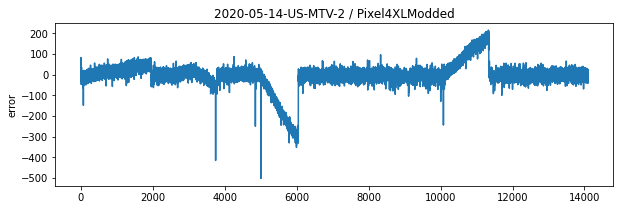

Loading ../../input/google-smartphone-decimeter-challenge/train/2020-05-21-US-MTV-1/Pixel4/Pixel4_GnssLog.txt


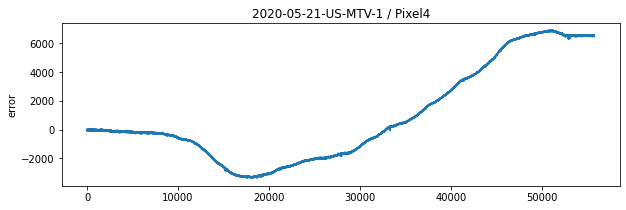

Loading ../../input/google-smartphone-decimeter-challenge/train/2020-05-21-US-MTV-2/Pixel4/Pixel4_GnssLog.txt


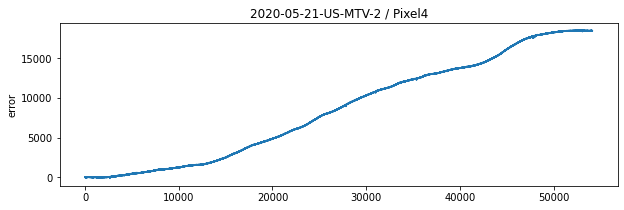

Loading ../../input/google-smartphone-decimeter-challenge/train/2020-05-21-US-MTV-2/Pixel4XL/Pixel4XL_GnssLog.txt


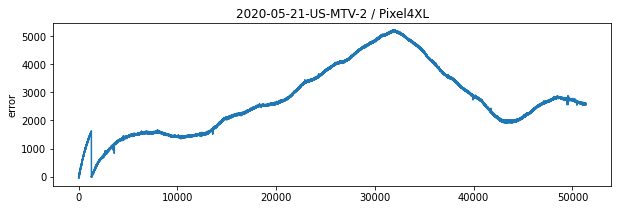

Loading ../../input/google-smartphone-decimeter-challenge/train/2020-05-29-US-MTV-1/Pixel4/Pixel4_GnssLog.txt


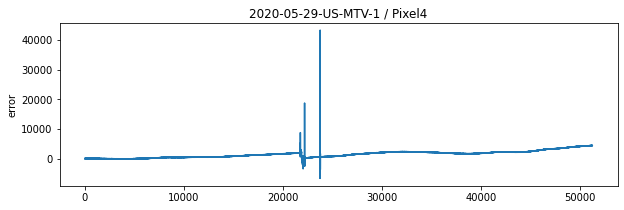

Loading ../../input/google-smartphone-decimeter-challenge/train/2020-05-29-US-MTV-1/Pixel4XL/Pixel4XL_GnssLog.txt


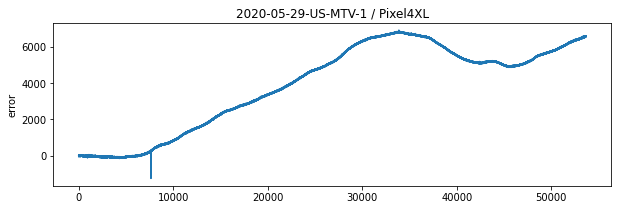

Loading ../../input/google-smartphone-decimeter-challenge/train/2020-05-29-US-MTV-1/Pixel4XLModded/Pixel4XLModded_GnssLog.txt


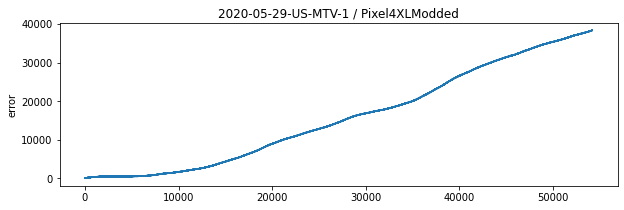

Loading ../../input/google-smartphone-decimeter-challenge/train/2020-05-29-US-MTV-2/Pixel4/Pixel4_GnssLog.txt


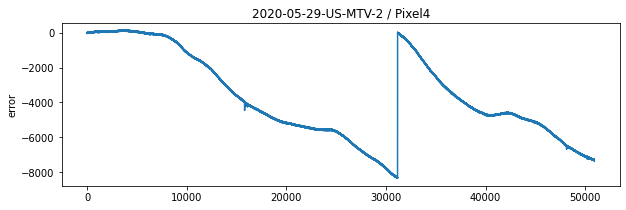

Loading ../../input/google-smartphone-decimeter-challenge/train/2020-05-29-US-MTV-2/Pixel4XL/Pixel4XL_GnssLog.txt


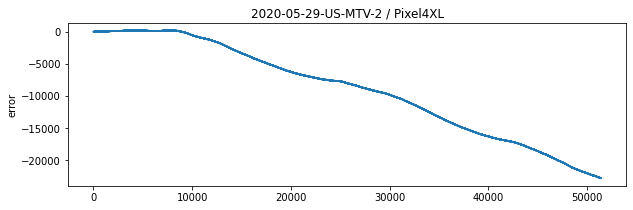

Loading ../../input/google-smartphone-decimeter-challenge/train/2020-06-04-US-MTV-1/Pixel4/Pixel4_GnssLog.txt


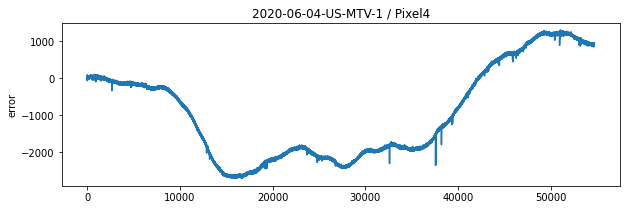

Loading ../../input/google-smartphone-decimeter-challenge/train/2020-06-04-US-MTV-1/Pixel4XL/Pixel4XL_GnssLog.txt


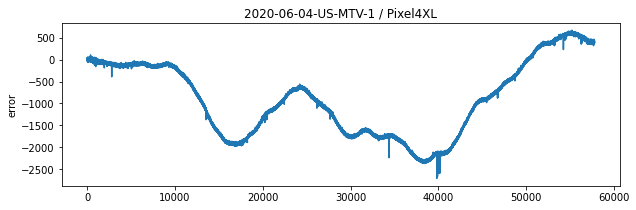

Loading ../../input/google-smartphone-decimeter-challenge/train/2020-06-04-US-MTV-1/Pixel4XLModded/Pixel4XLModded_GnssLog.txt


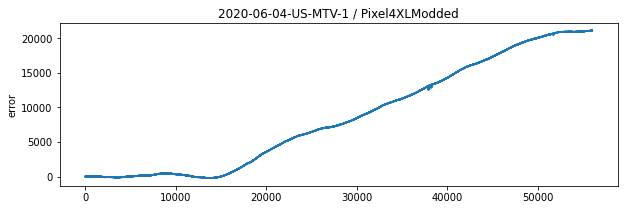

Loading ../../input/google-smartphone-decimeter-challenge/train/2020-06-05-US-MTV-1/Pixel4/Pixel4_GnssLog.txt


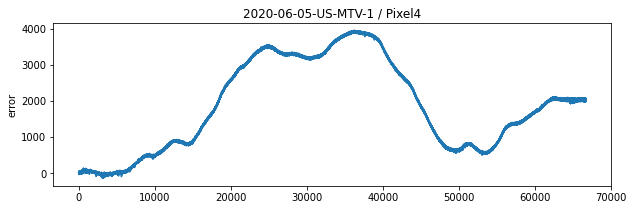

Loading ../../input/google-smartphone-decimeter-challenge/train/2020-06-05-US-MTV-1/Pixel4XL/Pixel4XL_GnssLog.txt


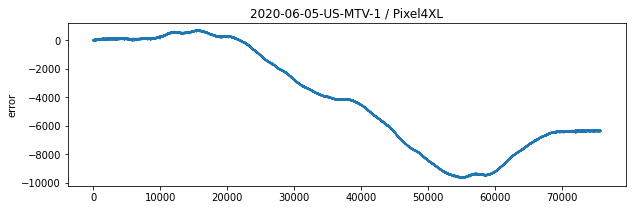

Loading ../../input/google-smartphone-decimeter-challenge/train/2020-06-05-US-MTV-1/Pixel4XLModded/Pixel4XLModded_GnssLog.txt


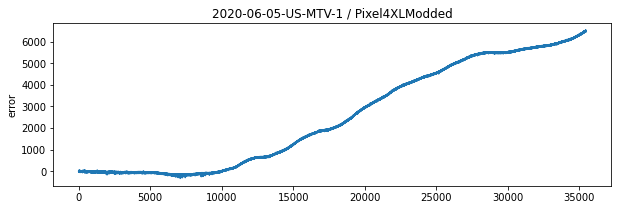

Loading ../../input/google-smartphone-decimeter-challenge/train/2020-06-05-US-MTV-2/Pixel4/Pixel4_GnssLog.txt


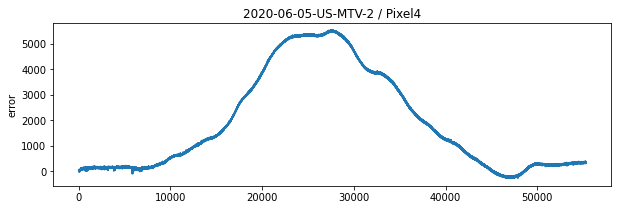

Loading ../../input/google-smartphone-decimeter-challenge/train/2020-06-05-US-MTV-2/Pixel4XL/Pixel4XL_GnssLog.txt


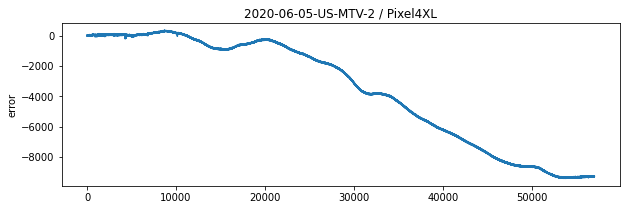

Loading ../../input/google-smartphone-decimeter-challenge/train/2020-06-11-US-MTV-1/Pixel4/Pixel4_GnssLog.txt


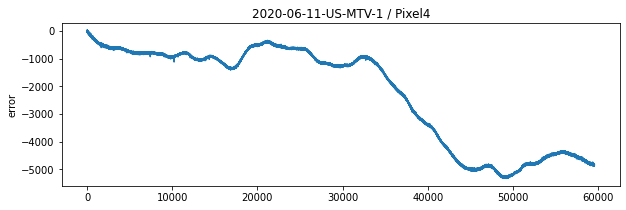

Loading ../../input/google-smartphone-decimeter-challenge/train/2020-06-11-US-MTV-1/Pixel4XL/Pixel4XL_GnssLog.txt


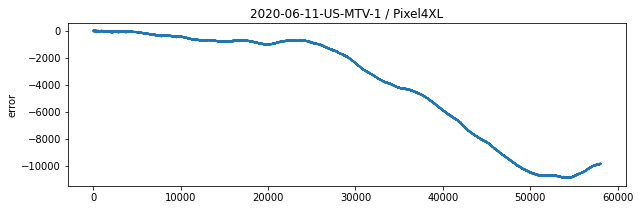

Loading ../../input/google-smartphone-decimeter-challenge/train/2020-07-08-US-MTV-1/Pixel4/Pixel4_GnssLog.txt


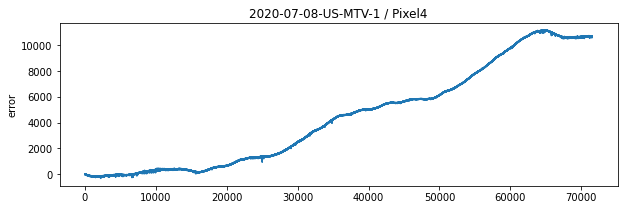

Loading ../../input/google-smartphone-decimeter-challenge/train/2020-07-08-US-MTV-1/Pixel4XL/Pixel4XL_GnssLog.txt


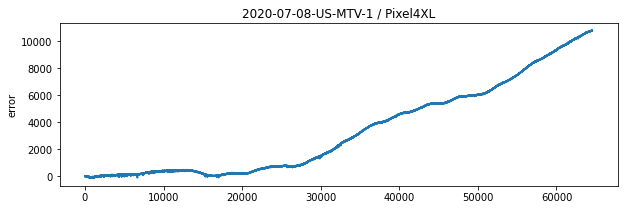

Loading ../../input/google-smartphone-decimeter-challenge/train/2020-07-08-US-MTV-1/Pixel4XLModded/Pixel4XLModded_GnssLog.txt


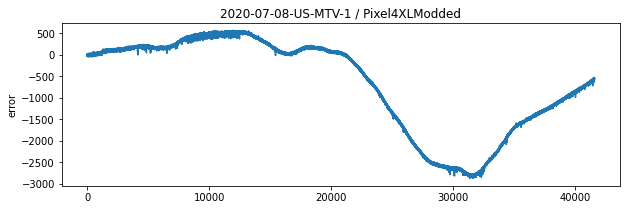

Loading ../../input/google-smartphone-decimeter-challenge/train/2020-07-17-US-MTV-1/Mi8/Mi8_GnssLog.txt


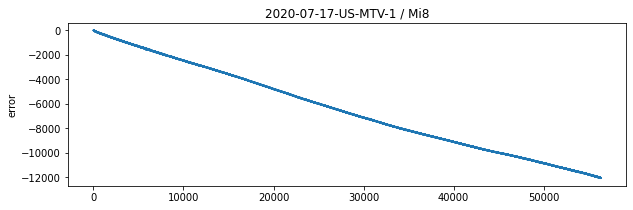

Loading ../../input/google-smartphone-decimeter-challenge/train/2020-07-17-US-MTV-2/Mi8/Mi8_GnssLog.txt


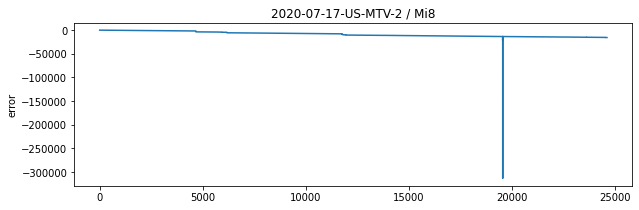

Loading ../../input/google-smartphone-decimeter-challenge/train/2020-08-03-US-MTV-1/Mi8/Mi8_GnssLog.txt


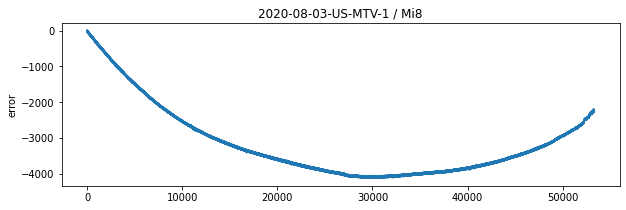

Loading ../../input/google-smartphone-decimeter-challenge/train/2020-08-03-US-MTV-1/Pixel4/Pixel4_GnssLog.txt


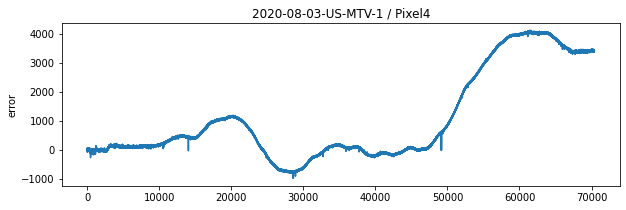

Loading ../../input/google-smartphone-decimeter-challenge/train/2020-08-06-US-MTV-2/Mi8/Mi8_GnssLog.txt


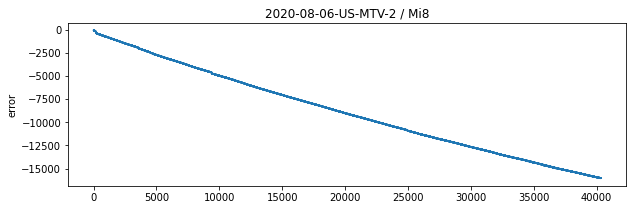

Loading ../../input/google-smartphone-decimeter-challenge/train/2020-08-06-US-MTV-2/Pixel4/Pixel4_GnssLog.txt


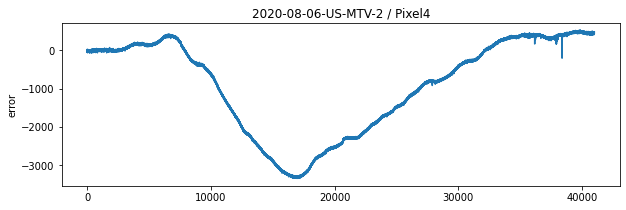

Loading ../../input/google-smartphone-decimeter-challenge/train/2020-08-06-US-MTV-2/Pixel4XL/Pixel4XL_GnssLog.txt


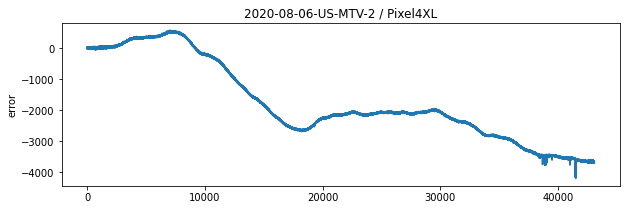

Loading ../../input/google-smartphone-decimeter-challenge/train/2020-09-04-US-SF-1/Mi8/Mi8_GnssLog.txt


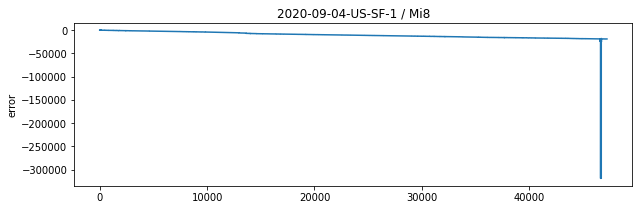

Loading ../../input/google-smartphone-decimeter-challenge/train/2020-09-04-US-SF-1/Pixel4/Pixel4_GnssLog.txt


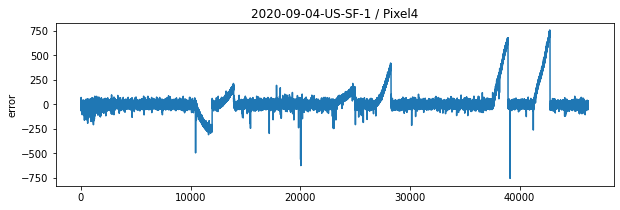

Loading ../../input/google-smartphone-decimeter-challenge/train/2020-09-04-US-SF-1/Pixel4XL/Pixel4XL_GnssLog.txt


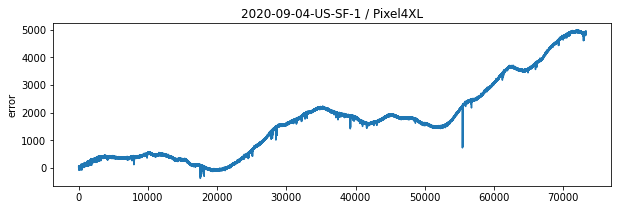

Loading ../../input/google-smartphone-decimeter-challenge/train/2020-09-04-US-SF-2/Mi8/Mi8_GnssLog.txt


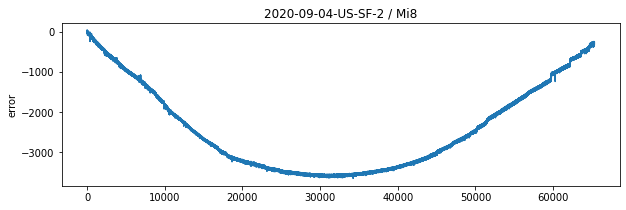

Loading ../../input/google-smartphone-decimeter-challenge/train/2020-09-04-US-SF-2/Pixel4/Pixel4_GnssLog.txt


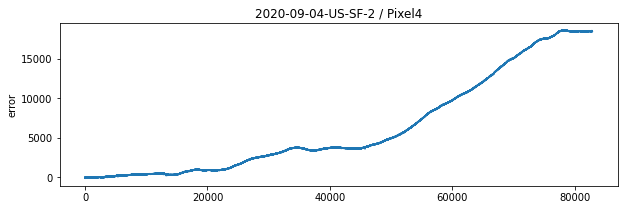

Loading ../../input/google-smartphone-decimeter-challenge/train/2020-09-04-US-SF-2/Pixel4XL/Pixel4XL_GnssLog.txt


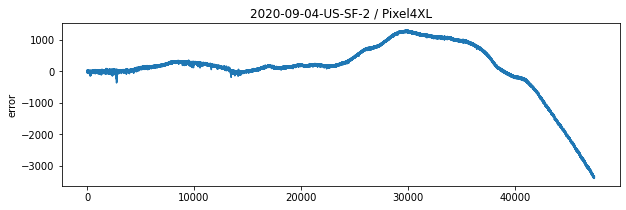

Loading ../../input/google-smartphone-decimeter-challenge/train/2021-01-04-US-RWC-1/Pixel4/Pixel4_GnssLog.txt


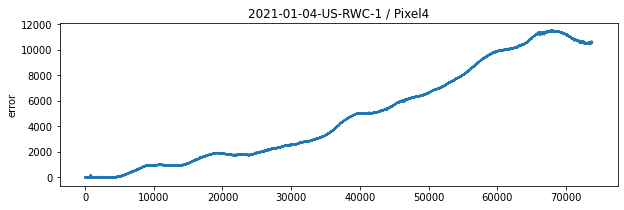

Loading ../../input/google-smartphone-decimeter-challenge/train/2021-01-04-US-RWC-1/Pixel4Modded/Pixel4Modded_GnssLog.txt


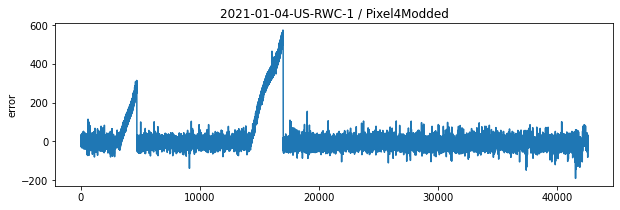

Loading ../../input/google-smartphone-decimeter-challenge/train/2021-01-04-US-RWC-1/Pixel4XL/Pixel4XL_GnssLog.txt


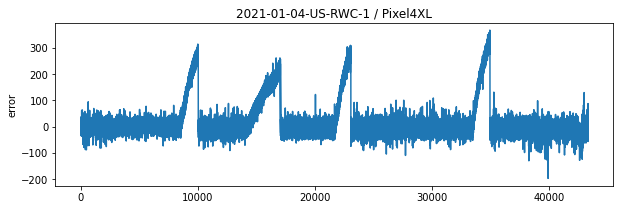

Loading ../../input/google-smartphone-decimeter-challenge/train/2021-01-04-US-RWC-1/Pixel5/Pixel5_GnssLog.txt


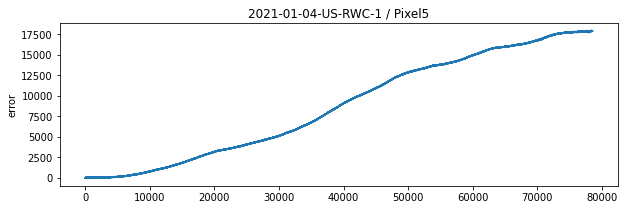

Loading ../../input/google-smartphone-decimeter-challenge/train/2021-01-04-US-RWC-2/Pixel4/Pixel4_GnssLog.txt


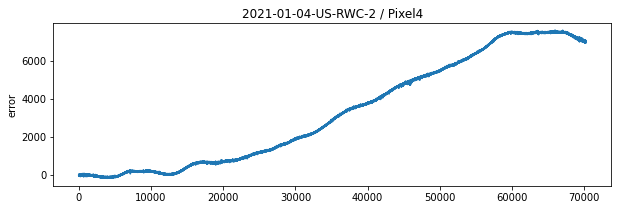

Loading ../../input/google-smartphone-decimeter-challenge/train/2021-01-04-US-RWC-2/Pixel4Modded/Pixel4Modded_GnssLog.txt


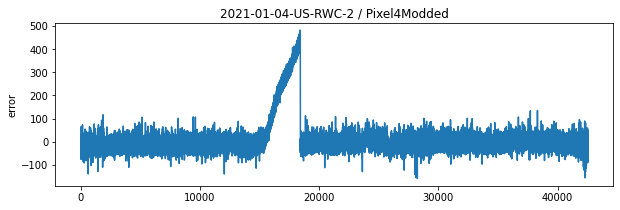

Loading ../../input/google-smartphone-decimeter-challenge/train/2021-01-04-US-RWC-2/Pixel4XL/Pixel4XL_GnssLog.txt


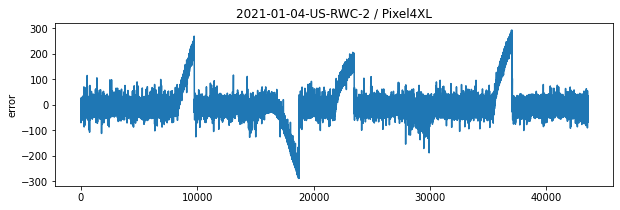

Loading ../../input/google-smartphone-decimeter-challenge/train/2021-01-04-US-RWC-2/Pixel5/Pixel5_GnssLog.txt


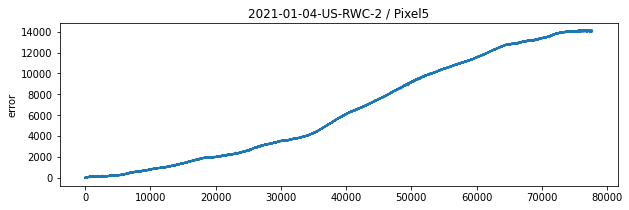

Loading ../../input/google-smartphone-decimeter-challenge/train/2021-01-05-US-SVL-1/Mi8/Mi8_GnssLog.txt


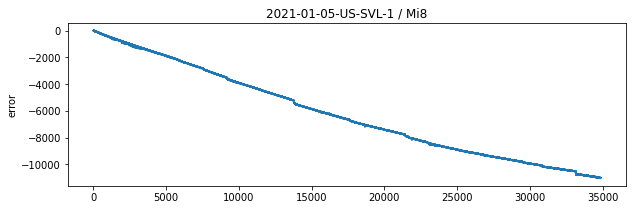

Loading ../../input/google-smartphone-decimeter-challenge/train/2021-01-05-US-SVL-1/Pixel4/Pixel4_GnssLog.txt


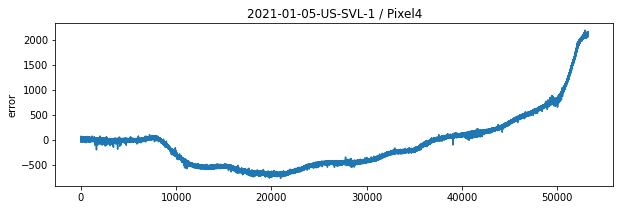

Loading ../../input/google-smartphone-decimeter-challenge/train/2021-01-05-US-SVL-1/Pixel4XL/Pixel4XL_GnssLog.txt


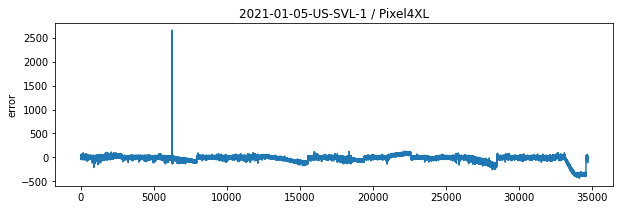

Loading ../../input/google-smartphone-decimeter-challenge/train/2021-01-05-US-SVL-1/Pixel5/Pixel5_GnssLog.txt


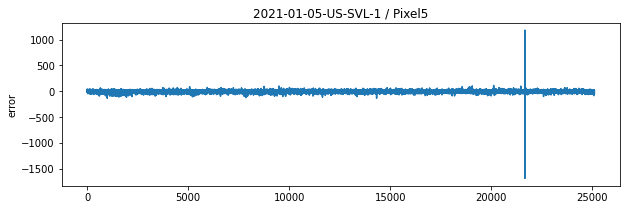

Loading ../../input/google-smartphone-decimeter-challenge/train/2021-01-05-US-SVL-2/Pixel4/Pixel4_GnssLog.txt


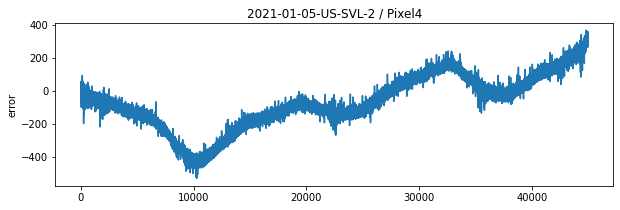

Loading ../../input/google-smartphone-decimeter-challenge/train/2021-01-05-US-SVL-2/Pixel4Modded/Pixel4Modded_GnssLog.txt


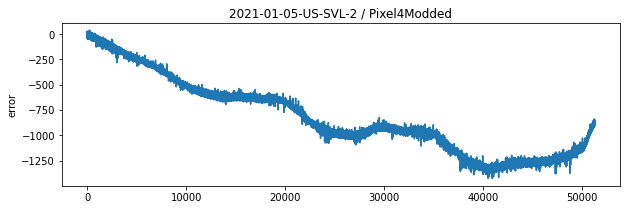

Loading ../../input/google-smartphone-decimeter-challenge/train/2021-01-05-US-SVL-2/Pixel4XL/Pixel4XL_GnssLog.txt


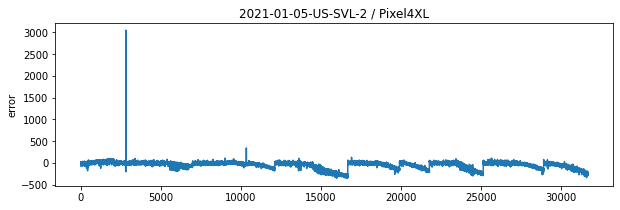

Loading ../../input/google-smartphone-decimeter-challenge/train/2021-03-10-US-SVL-1/Pixel4XL/Pixel4XL_GnssLog.txt


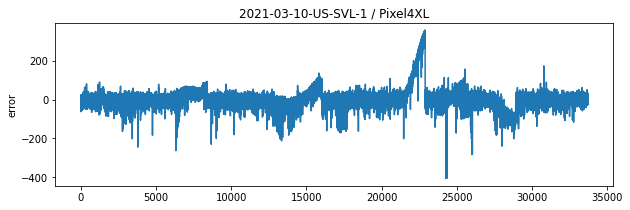

Loading ../../input/google-smartphone-decimeter-challenge/train/2021-03-10-US-SVL-1/SamsungS20Ultra/SamsungS20Ultra_GnssLog.txt


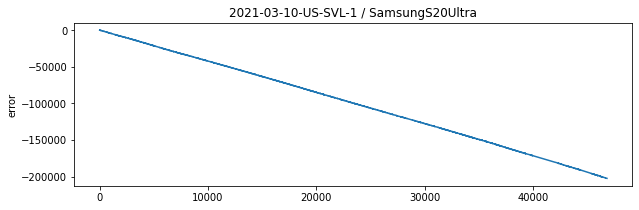

Loading ../../input/google-smartphone-decimeter-challenge/train/2021-04-15-US-MTV-1/Pixel4/Pixel4_GnssLog.txt


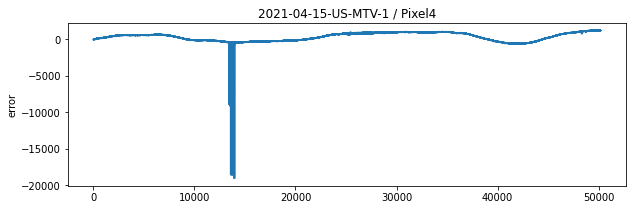

Loading ../../input/google-smartphone-decimeter-challenge/train/2021-04-15-US-MTV-1/Pixel4Modded/Pixel4Modded_GnssLog.txt


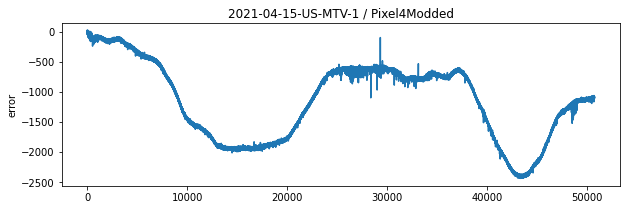

Loading ../../input/google-smartphone-decimeter-challenge/train/2021-04-15-US-MTV-1/Pixel5/Pixel5_GnssLog.txt


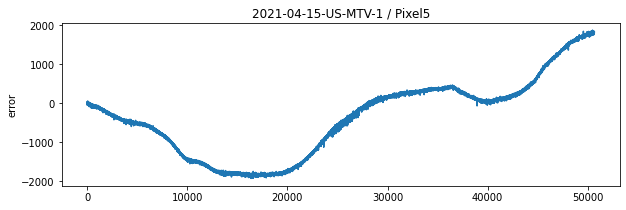

Loading ../../input/google-smartphone-decimeter-challenge/train/2021-04-15-US-MTV-1/SamsungS20Ultra/SamsungS20Ultra_GnssLog.txt


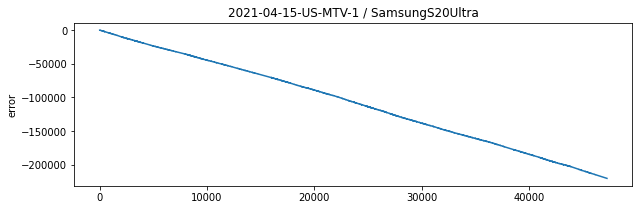

Loading ../../input/google-smartphone-decimeter-challenge/train/2021-04-22-US-SJC-1/Pixel4/Pixel4_GnssLog.txt


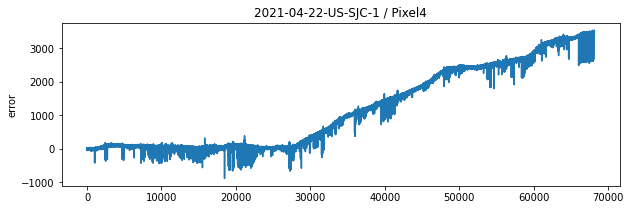

Loading ../../input/google-smartphone-decimeter-challenge/train/2021-04-22-US-SJC-1/SamsungS20Ultra/SamsungS20Ultra_GnssLog.txt


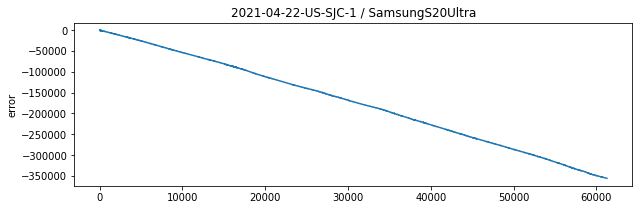

Loading ../../input/google-smartphone-decimeter-challenge/train/2021-04-26-US-SVL-1/Mi8/Mi8_GnssLog.txt


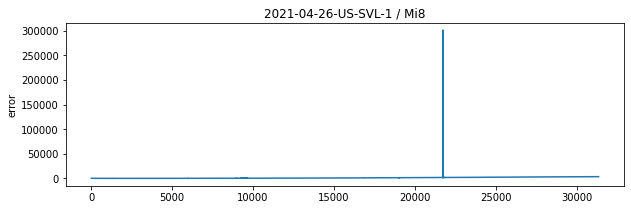

Loading ../../input/google-smartphone-decimeter-challenge/train/2021-04-26-US-SVL-1/Pixel5/Pixel5_GnssLog.txt


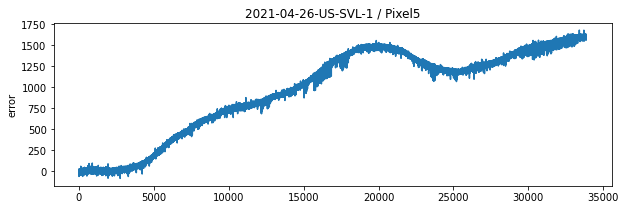

Loading ../../input/google-smartphone-decimeter-challenge/train/2021-04-28-US-MTV-1/Pixel4/Pixel4_GnssLog.txt


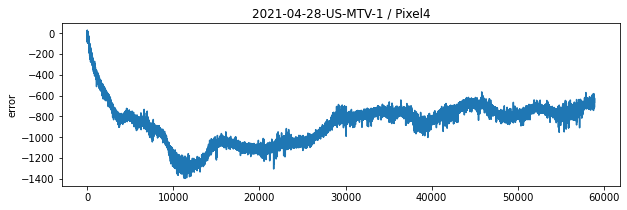

Loading ../../input/google-smartphone-decimeter-challenge/train/2021-04-28-US-MTV-1/Pixel5/Pixel5_GnssLog.txt


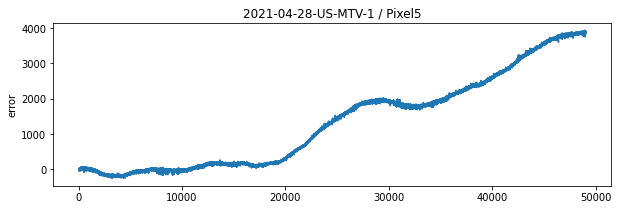

Loading ../../input/google-smartphone-decimeter-challenge/train/2021-04-28-US-MTV-1/SamsungS20Ultra/SamsungS20Ultra_GnssLog.txt


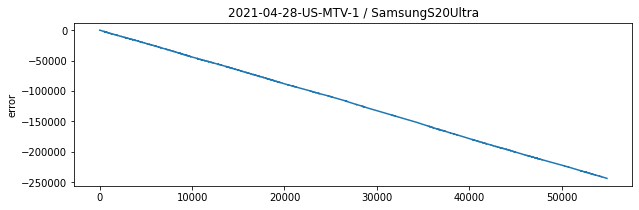

Loading ../../input/google-smartphone-decimeter-challenge/train/2021-04-28-US-SJC-1/Pixel4/Pixel4_GnssLog.txt


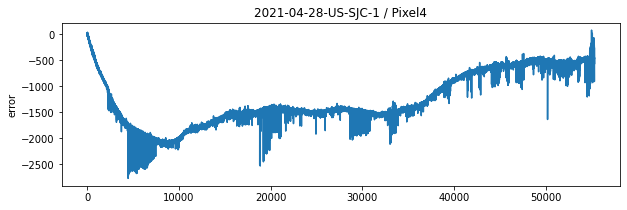

Loading ../../input/google-smartphone-decimeter-challenge/train/2021-04-28-US-SJC-1/SamsungS20Ultra/SamsungS20Ultra_GnssLog.txt


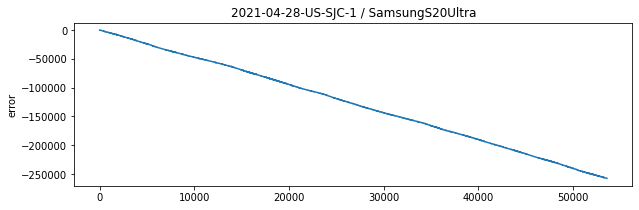

Loading ../../input/google-smartphone-decimeter-challenge/train/2021-04-29-US-MTV-1/Pixel4/Pixel4_GnssLog.txt


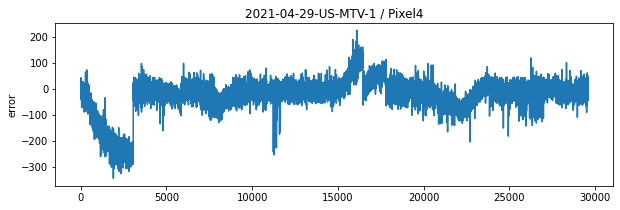

Loading ../../input/google-smartphone-decimeter-challenge/train/2021-04-29-US-MTV-1/Pixel5/Pixel5_GnssLog.txt


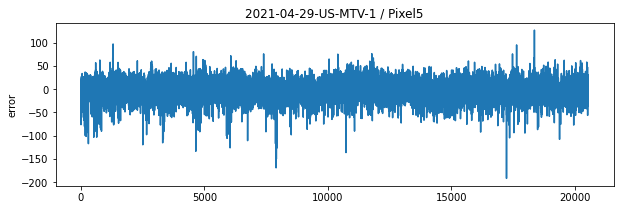

Loading ../../input/google-smartphone-decimeter-challenge/train/2021-04-29-US-MTV-1/SamsungS20Ultra/SamsungS20Ultra_GnssLog.txt


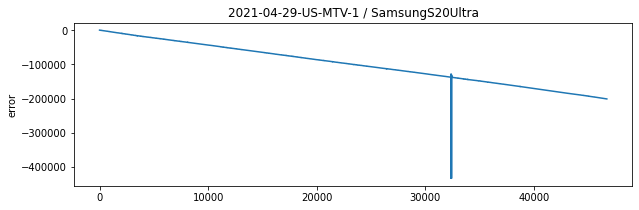

Loading ../../input/google-smartphone-decimeter-challenge/train/2021-04-29-US-SJC-2/Pixel4/Pixel4_GnssLog.txt


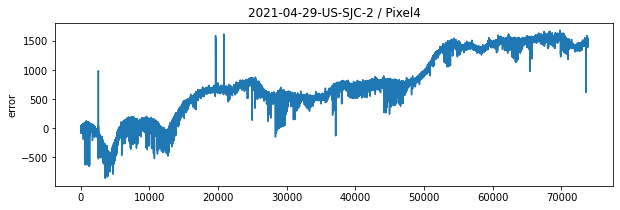

Loading ../../input/google-smartphone-decimeter-challenge/train/2021-04-29-US-SJC-2/SamsungS20Ultra/SamsungS20Ultra_GnssLog.txt


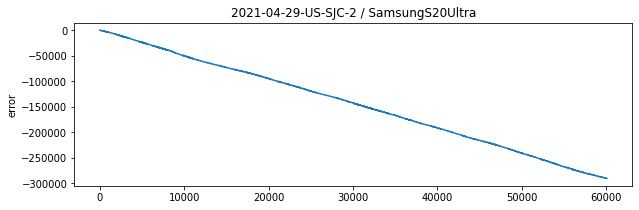

In [8]:
train_df = create_dataset(base_train, phase='train', show=True)

In [9]:
test_df = create_dataset(base_test, phase='test', show=True)

  0%|          | 0/48 [00:00<?, ?it/s]

Loading ../../input/google-smartphone-decimeter-challenge/test/2020-05-15-US-MTV-1/Pixel4/Pixel4_GnssLog.txt
Loading ../../input/google-smartphone-decimeter-challenge/test/2020-05-15-US-MTV-1/Pixel4XL/Pixel4XL_GnssLog.txt
Loading ../../input/google-smartphone-decimeter-challenge/test/2020-05-28-US-MTV-1/Pixel4/Pixel4_GnssLog.txt
Loading ../../input/google-smartphone-decimeter-challenge/test/2020-05-28-US-MTV-1/Pixel4XL/Pixel4XL_GnssLog.txt
Loading ../../input/google-smartphone-decimeter-challenge/test/2020-05-28-US-MTV-2/Pixel4/Pixel4_GnssLog.txt
Loading ../../input/google-smartphone-decimeter-challenge/test/2020-05-28-US-MTV-2/Pixel4XL/Pixel4XL_GnssLog.txt
Loading ../../input/google-smartphone-decimeter-challenge/test/2020-05-28-US-MTV-2/Pixel4XLModded/Pixel4XLModded_GnssLog.txt
Loading ../../input/google-smartphone-decimeter-challenge/test/2020-06-04-US-MTV-2/Pixel4/Pixel4_GnssLog.txt
Loading ../../input/google-smartphone-decimeter-challenge/test/2020-06-04-US-MTV-2/Pixel4XL/Pixel4XL

- 上記のようにcorrectedPrMとground truthのPrMには誤差がある。
- 端末ごとに誤差の傾向がありそう(これは端末側の時刻誤差を表している?）   
- これを予測したい  

In [10]:
train_df.to_csv("train.csv", index=False)
test_df.to_csv("test.csv", index=False)

In [61]:
train_df = pd.read_csv("train.csv")
test_df = pd.read_csv("test.csv")

## 特徴量エンジニアリング

In [62]:
set(train_df.columns) - set(test_df.columns)

{'heightAboveWgs84EllipsoidM', 'latDeg', 'lngDeg', 'rM_gt', 'x', 'y', 'z'}

In [63]:
train_df.head()

,collectionName,phoneName,millisSinceGpsEpoch,constellationType,svid,signalType,receivedSvTimeInGpsNanos,xSatPosM,ySatPosM,zSatPosM,...,ionoDelayM,tropoDelayM,correctedPrM,latDeg,lngDeg,heightAboveWgs84EllipsoidM,x,y,z,rM_gt
0,2020-05-14-US-MTV-1,Pixel4,1273529463442,3,24,GLO_G1,1273529463363061857,-2.539901e+07,-6.925122e+05,-2.280430e+06,...,10.866,16.647,2.379335e+07,37.423576,-122.094132,-27.79,-2.694570e+06,-4.296490e+06,3.854815e+06,2.379331e+07
1,2020-05-14-US-MTV-1,Pixel4,1273529463442,6,21,GAL_E5A,1273529463364082168,-1.484042e+07,-2.110960e+07,1.449632e+07,...,6.875,2.544,2.331189e+07,37.423576,-122.094132,-27.79,-2.694570e+06,-4.296490e+06,3.854815e+06,2.331188e+07
2,2020-05-14-US-MTV-1,Pixel4,1273529463442,1,6,GPS_L5,1273529463367963648,6.164667e+06,-1.358509e+07,2.202452e+07,...,9.864,4.095,2.224639e+07,37.423576,-122.094132,-27.79,-2.694570e+06,-4.296490e+06,3.854815e+06,2.224640e+07
3,2020-05-14-US-MTV-1,Pixel4,1273529463442,6,15,GAL_E5A,1273529463352387649,1.635469e+07,-1.047833e+07,2.234460e+07,...,14.288,9.151,2.725729e+07,37.423576,-122.094132,-27.79,-2.694570e+06,-4.296490e+06,3.854815e+06,2.725732e+07
4,2020-05-14-US-MTV-1,Pixel4,1273529463442,6,27,GAL_E5A,1273529463355965922,-4.073578e+06,-2.905685e+07,-3.925515e+06,...,12.751,5.174,2.599058e+07,37.423576,-122.094132,-27.79,-2.694570e+06,-4.296490e+06,3.854815e+06,2.599059e+07


In [64]:
train_df.columns

Index(['collectionName', 'phoneName', 'millisSinceGpsEpoch',
       'constellationType', 'svid', 'signalType', 'receivedSvTimeInGpsNanos',
       'xSatPosM', 'ySatPosM', 'zSatPosM', 'xSatVelMps', 'ySatVelMps',
       'zSatVelMps', 'satClkBiasM', 'satClkDriftMps', 'rawPrM', 'rawPrUncM',
       'isrbM', 'ionoDelayM', 'tropoDelayM', 'correctedPrM', 'latDeg',
       'lngDeg', 'heightAboveWgs84EllipsoidM', 'x', 'y', 'z', 'rM_gt'],
      dtype='object')

In [65]:
# def UTC2GpsEpoch(df):
#     '''UTC to GpsEpoch
    
#     utcTimeMillis         : UTC epoch (1970/1/1)
#     millisSinceGpsEpoch   : GPS epoch(1980/1/6 midnight 12:00 UTC)
    
#     Ref: https://www.kaggle.com/c/google-smartphone-decimeter-challenge/discussion/239187
#     '''
#     dt_offset = pd.to_datetime('1980-01-06 00:00:00') 
#     dt_offset_in_ms = int(dt_offset.value / 1e6)
#     df['millisSinceGpsEpoch'] = df['utcTimeMillis'] - dt_offset_in_ms + 18000
#     return df

# def GpsEpoch2UTC(df):
#     '''UTC to GpsEpoch
    
#     utcTimeMillis         : UTC epoch (1970/1/1)
#     millisSinceGpsEpoch   : GPS epoch(1980/1/6 midnight 12:00 UTC)
    
#     Ref: https://www.kaggle.com/c/google-smartphone-decimeter-challenge/discussion/239187
#     '''
#     dt_offset = pd.to_datetime('1980-01-06 00:00:00') 
#     dt_offset_in_ms = int(dt_offset.value / 1e6)
#     df['utcTimeMillis'] = (df['millisSinceGpsEpoch'] - 18000 + dt_offset_in_ms)/1000
#     return df

In [66]:
train = train_df.copy()
test = test_df.copy()

In [67]:
from sklearn import preprocessing
co_le = preprocessing.LabelEncoder()
ph_le = preprocessing.LabelEncoder()
sg_le = preprocessing.LabelEncoder()

whole = pd.concat([train,test])
co_le.fit(whole["collectionName"])
ph_le.fit(whole["phoneName"])
sg_le.fit(whole["signalType"])

train["collectionName"] = co_le.transform(train["collectionName"])
test["collectionName"] = co_le.transform(test["collectionName"])
train["phoneName"] = ph_le.transform(train["phoneName"])
test["phoneName"] = ph_le.transform(test["phoneName"])
train["signalType"] = sg_le.transform(train["signalType"])
test["signalType"] = sg_le.transform(test["signalType"])

In [68]:

params = {
    # 目的関数. これの意味で最小となるようなパラメータを探します. 
    'objective': 'mse', 
    'metric':'mse',

     # 学習率. 小さいほどなめらかな決定境界が作られて性能向上に繋がる場合が多いです、
    # がそれだけ木を作るため学習に時間がかかります
    'learning_rate': .01,

    # L2 Reguralization
    'reg_lambda': 1.,
    # こちらは L1 
    'reg_alpha': .1,

    # 木の深さ. 深い木を許容するほどより複雑な交互作用を考慮するようになります
    'max_depth': 5, 

    # 木の最大数. early_stopping という枠組みで木の数は制御されるようにしていますのでとても大きい値を指定しておきます.
    'n_estimators': 10000, 

    # 木を作る際に考慮する特徴量の割合. 1以下を指定すると特徴をランダムに欠落させます。小さくすることで, まんべんなく特徴を使うという効果があります.
    'colsample_bytree': .5,

    # 最小分割でのデータ数. 小さいとより細かい粒度の分割方法を許容します.
    'min_child_samples': 10,

    # bagging の頻度と割合
    'subsample_freq': 3,
    'subsample': .9,

    # 特徴重要度計算のロジック(後述)
    'importance_type': 'gain', 
    'random_state': 71,
}

In [74]:
import lightgbm as lgb
from sklearn.multioutput import MultiOutputRegressor
from sklearn.metrics import mean_squared_error
from wandb.lightgbm import wandb_callback
from sklearn.model_selection import StratifiedKFold, GroupKFold, KFold
import wandb
# import optuna.integration.lightgbm as lgb

def fit_lgbm(train_df,
             test_df,
             target=None,
             params: dict=None, 
             pretrained_exp=None,
             verbose: int=50
             ):

    feature_names = [f for f in list(train_df) if f not in ['heightAboveWgs84EllipsoidM', 'latDeg', 'lngDeg', 'rM_gt', 'x', 'y', 'z']]
    
    # パラメータがないときは、空の dict で置き換える
    if params is None:
        params = {}

    oofs = []  # 全てのoofをdfで格納する
    preds = []  # 全ての予測値をdfで格納する
    val_scores = []
    kf = KFold(n_splits=5, shuffle=True, random_state=0)
    # skf = StratifiedKFold(n_splits=N_SPLITS, shuffle=True, random_state=SEED)
    # gkf = GroupKFold(n_splits=5)
    train_fold = [(trn_idx, val_idx) for trn_idx, val_idx in kf.split(train_df)]
    # train_fold = [(trn_idx, val_idx) for trn_idx, val_idx in gkf.split(train_df, groups=train_df['collectionName'])]
    for fold in range(5):
        print('=' * 20)
        print(f'Fold {fold}')
        print('=' * 20)


        # training data の target と同じだけのゼロ配列を用意
        oof_pred = np.zeros(train_df.shape[0], dtype=np.float)

        # train/valid data
        trn_idx_for_train, val_idx_for_train = train_fold[fold]
        x_train = train_df.loc[trn_idx_for_train, feature_names]  # .reset_index(drop=True)
        x_valid = train_df.loc[val_idx_for_train, feature_names]  # .reset_index(drop=True)
        y_train = train_df.loc[trn_idx_for_train, target]  # .reset_index(drop=True)
        y_valid = train_df.loc[val_idx_for_train, target]  # .reset_index(drop=True)

        if pretrained_exp is None:
            model_dir = f"../../model/{EXP_NAME}/"
            os.makedirs(model_dir, exist_ok=True)
        else:
            model_dir = f"../../model/{pretrained_exp}/"
        # logger
        wandb.init(project='outdoor', entity='kuto5046', group=EXP_NAME)
        wandb.run.name = EXP_NAME + f'-fold-{fold}'
        wandb_config = wandb.config
        wandb_config['model_name'] = "lightGBM"
        
        if os.path.exists(model_dir + f'fold{fold}.pkl'):
            clf = pickle.load(open(model_dir + f'fold{fold}.pkl', 'rb'))
        else:
            clf = lgb.LGBMRegressor(**params)
            clf.fit(x_train, y_train,
                    eval_set=[(x_valid, y_valid)],  
                    early_stopping_rounds=50,
                    verbose=verbose,
                    callbacks=[wandb_callback()])
            pickle.dump(clf, open(model_dir + f'fold{fold}.pkl', 'wb'))

        pred_i = clf.predict(x_valid)
        x_valid[f"rM_pred"] = pred_i
        x_valid[target] = y_valid.to_numpy()
                
        # x_valid["collectionName"] = train.loc[val_idx_for_train, "collectionName"].values
        # x_valid["phoneName"] = train.loc[val_idx_for_train, "phoneName"].values        
        oofs.append(x_valid)
        
        score = mean_squared_error(y_valid, pred_i)
        val_scores.append(score)
        print(f'Fold {fold} MSE: {score:.4f}')

        wandb.finish()

        pred = clf.predict(test_df[feature_names])
        preds.append(pred)
    oof_df = pd.concat(oofs).sort_index() 
    all_score = mean_squared_error(oof_df[target], oof_df["rM_pred"])
    print('-' * 50)
    print('FINISHED | Whole MSE: {:.4f}'.format(all_score))
    features = x_train.columns.values
    return oof_df, np.mean(preds, axis=0)

In [75]:
pretrained_exp = None
target = 'rM_gt'
oof, pred = fit_lgbm(train, test, target, params, pretrained_exp, verbose=100)

Fold 0


KeyError: 'rm_gt'